In [26]:
import os
import time
import numpy as np
import pandas as pd

from skimage import io

from CellMet.segmentation import Segmentation
from CellMet.analysis import cell_analysis, edge_analysis, face_analysis
import ZebrafishMuscle.plot as ZMplot

import plotly.graph_objects as go
import matplotlib.pyplot as plt

%load_ext snakeviz

The snakeviz extension is already loaded. To reload it, use:
  %reload_ext snakeviz


In [ ]:
%pdb

In [1]:
# path = "/mnt/sda1/images/"
# seg_filename = "E4_36hpf_CAAXxZO1tdTom(d)-2_cp_masks.tif"
path = "/mnt/sda1/CellSegPaperDatas/Heart_data/"
seg_filename = "stack_denoised-edited-1-killBorders.tif"
pixel_size = dict(x_size = 0.1071804,
                  y_size = 0.1071804,
                  z_size = 0.1071804,)

# pixel_size = dict(x_size = 0.183,
#                   y_size = 0.183,
#                   z_size = 0.5,)

In [3]:

image = io.imread(os.path.join(path, seg_filename))


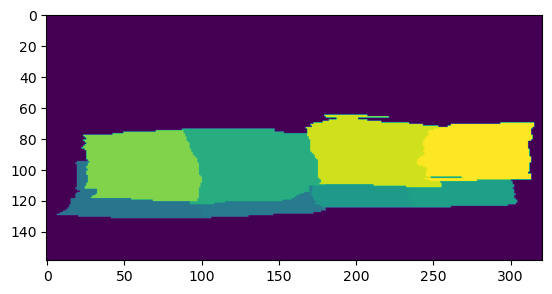

In [7]:
plt.imshow(image.max(axis=1))

In [ ]:
# # remove smallest cells
# val, count  = np.unique(image, return_counts=True)

# for i in val[np.where(count<50)]:
#     image[np.where(image==i)]=0

In [8]:
seg = Segmentation(image, pixel_size, path)

In [9]:
%%snakeviz
start_time = time.time()
seg.perform_prerequisite(save_mesh=True)
# print("--- %s seconds ---" % (time.time() - start_time))

 
*** Profile stats marshalled to file '/tmp/tmpf746eanj'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [10]:
%%snakeviz
cell_analysis(seg, parallelized=True, degree_convert=True)

/home/u2175049/anaconda3/lib/python3.11/site-packages/CellSeg/analysis.py:80: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  cell_plane_df = pd.concat([cell_plane_df, pd.DataFrame(cell_plane_out,  columns=cell_plane_columns)], ignore_index=True)


 
*** Profile stats marshalled to file '/tmp/tmp8dgb8d0o'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [11]:
%%snakeviz
start_time = time.time()
seg.cell_segmentation()
# print("--- %s seconds ---" % (time.time() - start_time))
# 168 sec

 
*** Profile stats marshalled to file '/tmp/tmpjuulzl3d'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [12]:
%%snakeviz
start_time = time.time()
seg.edge_segmentation()
# print("--- %s seconds ---" % (time.time() - start_time))
#2.09e+3

33
35
46
48
53
69
79
85
 
*** Profile stats marshalled to file '/tmp/tmpjtp42h34'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [13]:
%%snakeviz
start_time = time.time()
seg.face_segmentation()
# print("--- %s seconds ---" % (time.time() - start_time))

 
*** Profile stats marshalled to file '/tmp/tmp6m3f2lq0'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [14]:
%%snakeviz
edge_analysis(seg)

 
*** Profile stats marshalled to file '/tmp/tmp8ehoxxtp'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [15]:
%%snakeviz
cell_analysis(seg, parallelized=True, degree_convert=True)

/home/u2175049/anaconda3/lib/python3.11/site-packages/CellSeg/analysis.py:80: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  cell_plane_df = pd.concat([cell_plane_df, pd.DataFrame(cell_plane_out,  columns=cell_plane_columns)], ignore_index=True)


 
*** Profile stats marshalled to file '/tmp/tmp9aa0hap3'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [16]:
%%snakeviz
face_analysis(seg)

 
*** Profile stats marshalled to file '/tmp/tmpg745a_wg'.
Embedding SnakeViz in this document...
<function display at 0x7276278bbba0>


In [52]:
cell_df = pd.read_csv(os.path.join(path,"cell_df.csv"), index_col=0)
face_df = pd.read_csv(os.path.join(path,"face_df.csv"), index_col=0)
edge_df = pd.read_csv(os.path.join(path,"edge_df.csv"), index_col=0)

face_pixel_df = pd.read_csv(os.path.join(path,"face_pixel_df.csv"), index_col=0)
edge_pixel_df = pd.read_csv(os.path.join(path,"edge_pixel_df.csv"), index_col=0)

In [33]:
cell_df

,id_im,x_center,y_center,z_center,nb_neighbor,volume,area,real_dist,short_dist,curv_ind,orient_zy,orient_xy,orient_xz,x_start,y_start,z_start,x_end,y_end,z_end
0,33,62.827200,88.899310,112.468425,3,154.234950,1117.784392,9.724395,4.230692,0.564940,90.634821,-94.068935,-8.853281,82.574661,87.432127,92.0,76.5,87.0,131.0
1,35,140.166484,84.841223,110.504822,4,145.403196,1142.543064,9.645814,5.391624,0.441040,86.095786,-82.149214,-26.333221,139.272859,83.928882,85.0,117.0,87.0,130.0
2,46,206.604167,85.364340,105.522424,4,139.804704,1078.663546,11.533924,5.128323,0.555371,91.659783,92.336506,35.381410,199.303183,86.130095,85.0,227.0,85.0,124.0
3,48,267.065038,88.490631,104.376916,3,124.878265,997.635163,7.213553,4.475222,0.379609,74.155450,18.558965,5.443102,248.188525,78.647541,84.0,252.0,90.0,124.0
4,53,133.272887,44.852517,94.575360,5,158.726549,1267.944132,14.437191,5.662907,0.607756,76.357141,-58.154929,-21.344385,118.757267,48.349564,74.0,100.0,60.0,122.0
5,69,62.500964,44.197029,97.142917,3,141.746385,1106.316089,12.553788,5.389602,0.570679,63.598965,5.468857,2.721114,79.361233,34.660793,75.0,81.5,57.0,120.0
6,79,211.917411,41.534546,88.838954,4,125.224246,1070.303474,19.636245,7.679388,0.608918,63.539550,65.368245,47.348317,194.065854,34.104878,65.0,244.0,57.0,111.0
7,85,280.686436,40.566500,88.768980,2,111.956300,894.206077,8.715587,5.167886,0.407052,77.930611,-75.173423,-38.930204,304.387454,35.088561,70.0,274.5,43.0,107.0


In [48]:
fig = go.Figure()

for c_id in [33,35,46,48,53,69,79,85]:
# c_id = 79
    fig = ZMplot.draw_cell(image, c_id, fig=fig, **{"opacity":0.01})
    fig = ZMplot.draw_face(face_pixel_df, c_id, dict(x_size=1, y_size=1, z_size=1), fig=fig,)
    fig = ZMplot.draw_edges(edge_df, edge_pixel_df, c_id, dict(x_size=1, y_size=1, z_size=1), fig=fig)

fig.update_layout(title='Cell center, edge position',
              autosize=False,
              width=900,
              height=900,
              margin=dict(l=65, r=50, b=65, t=90),
              showlegend=False,
              scene = dict(
                aspectratio=dict(x=0.5, 
                                 y=pixel_size["x_size"], 
                                 z=pixel_size["x_size"]),
                ),
              )

fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )

In [76]:
cell_df

,id_im,x_center,y_center,z_center,nb_neighbor,volume,area,real_dist,short_dist,curv_ind,orient_zy,orient_xy,orient_xz,x_start,y_start,z_start,x_end,y_end,z_end
0,33,62.827200,88.899310,112.468425,3,154.234950,1117.784392,9.724395,4.230692,0.564940,90.634821,-94.068935,-8.853281,82.574661,87.432127,92.0,76.5,87.0,131.0
1,35,140.166484,84.841223,110.504822,4,145.403196,1142.543064,9.645814,5.391624,0.441040,86.095786,-82.149214,-26.333221,139.272859,83.928882,85.0,117.0,87.0,130.0
2,46,206.604167,85.364340,105.522424,4,139.804704,1078.663546,11.533924,5.128323,0.555371,91.659783,92.336506,35.381410,199.303183,86.130095,85.0,227.0,85.0,124.0
3,48,267.065038,88.490631,104.376916,3,124.878265,997.635163,7.213553,4.475222,0.379609,74.155450,18.558965,5.443102,248.188525,78.647541,84.0,252.0,90.0,124.0
4,53,133.272887,44.852517,94.575360,5,158.726549,1267.944132,14.437191,5.662907,0.607756,76.357141,-58.154929,-21.344385,118.757267,48.349564,74.0,100.0,60.0,122.0
5,69,62.500964,44.197029,97.142917,3,141.746385,1106.316089,12.553788,5.389602,0.570679,63.598965,5.468857,2.721114,79.361233,34.660793,75.0,81.5,57.0,120.0
6,79,211.917411,41.534546,88.838954,4,125.224246,1070.303474,19.636245,7.679388,0.608918,63.539550,65.368245,47.348317,194.065854,34.104878,65.0,244.0,57.0,111.0
7,85,280.686436,40.566500,88.768980,2,111.956300,894.206077,8.715587,5.167886,0.407052,77.930611,-75.173423,-38.930204,304.387454,35.088561,70.0,274.5,43.0,107.0


In [83]:
import networkx as nx
G = nx.Graph()
for c, row in cell_df.iterrows():
    G.add_node(row["id_im"], pos=row[["x_center", "y_center"]].to_numpy())
# G.add_nodes_from(cell_df["id_im"], pos=cell_df[["x_center", "y_center"]].to_numpy())
G.add_edges_from(face_df[["id_im_1", "id_im_2"]].to_numpy())

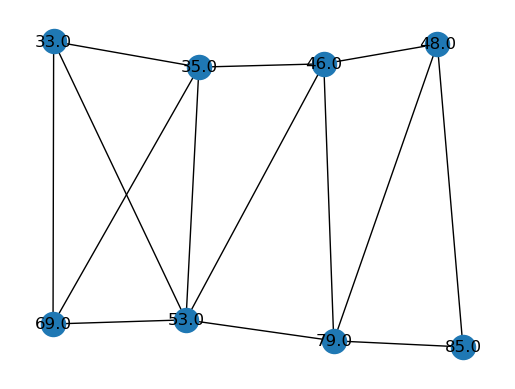

In [86]:
pos = nx.get_node_attributes(G,'pos')
fig, ax = plt.subplots()
nx.draw(G, with_labels=True,pos=pos, ax=ax)
fig.savefig(os.path.join(path, "network.eps"))

In [82]:
cell_df[["x_center", "y_center"]].to_numpy()[0]

array([62.82720006, 88.89931033])